In [1]:
%matplotlib notebook
import math
import os
import numpy as np
import sympy as sym
import pandas as pd
from matplotlib import rc
import matplotlib.pyplot as plt
from IPython.display import display, Math, Markdown
rc('font', **{'family': 'serif', 'serif': ['Computer Modern'], 'size': 20})
rc('text', usetex=True)
path = "C:/Users/Thomas/Laboratorio_Intermedio/Magnetic Torque/Data/"
path_ = "C:/Users/Thomas/Laboratorio_Intermedio/Magnetic Torque/Graphs/"
plt.rcParams["savefig.directory"] = path_

In [2]:
import scipy as sci
from scipy.signal import find_peaks, peak_widths
from scipy.special import wofz
from scipy.optimize import curve_fit
from scipy.constants import e
from scipy.constants import c
from scipy.constants import h

In [3]:
def Linear(X, a, b):
    return a*X + b

def Error(valor_principal, incertidumbre):
    # Determinar cuántas cifras significativas tiene la incertidumbre
    if incertidumbre == 0:
        return valor_principal, incertidumbre  # Evita la división por cero
    
    cifras_significativas = -int(math.floor(math.log10(incertidumbre)))
    
    # Redondear el valor principal y la incertidumbre a esas cifras significativas
    valor_redondeado = round(valor_principal, cifras_significativas)
    incertidumbre_redondeada = round(incertidumbre, cifras_significativas)
    
    return valor_redondeado, incertidumbre_redondeada

def Computation_Error(expression, symbols, parameters):
    error_2 = 0.
    ward = int((len(symbols)/2))
    func_value = sym.lambdify(symbols[0:ward], expression)
    value = func_value(*parameters[0:ward])

    for i in range(0, len(symbols[0:ward])):
        unc_ward = ward + i
        error_2 += sym.diff(expression, symbols[i])**2 * (symbols[unc_ward])**2

    func_error_2 = sym.lambdify(symbols, error_2)
    value_error_2 = func_error_2(*parameters)
    
    error = np.sqrt(value_error_2)
    
    value, error = Error(value, error)
    
    return value, error

> ## Bitácora - Experimento de Torque Magnético

**Hecho por:** Simón Felipe Jimenez Botero & Thomas Andrade Hernández.

---

En el presente documento se encuentran desglozados los resultados de las mediciones asociadas al montaje experimental de Torque Magnético. A lo largo de este código se podrán observar los resultados de cada medición, gráficas e información relacionada a cada una de las regresiones que se realicen, sumado a una breve explicación previa acerca de aquello que estamos haciendo, cómo lo estamos haciendo y alguna que otra cosa a tener presente para su replicación.

---

> **Montaje Experimental:**

Las mediciones que fueron realizadas a lo largo de las horas de laboratorio son derivadas del siguiente montaje experimental:

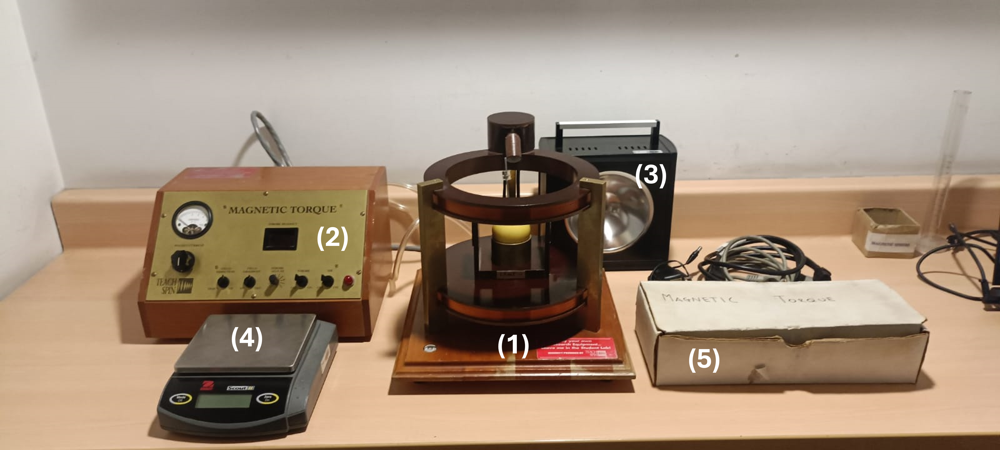

donde (1) es el montaje principal donde se encuentra la esfera, (2) el módulo que permite controlar la dirección del campo magnéntico, su intensidad (modificando la corriente) y el aire emitido; (3) el estroboscopio utilizado para medir frecuencia de oscilación, (4) balanza eléctrica para medir la masa de los objetos y (5) una caja que en su interior posee masas y elementos varios adicionales (y no utilizados) en nuestro experimento.

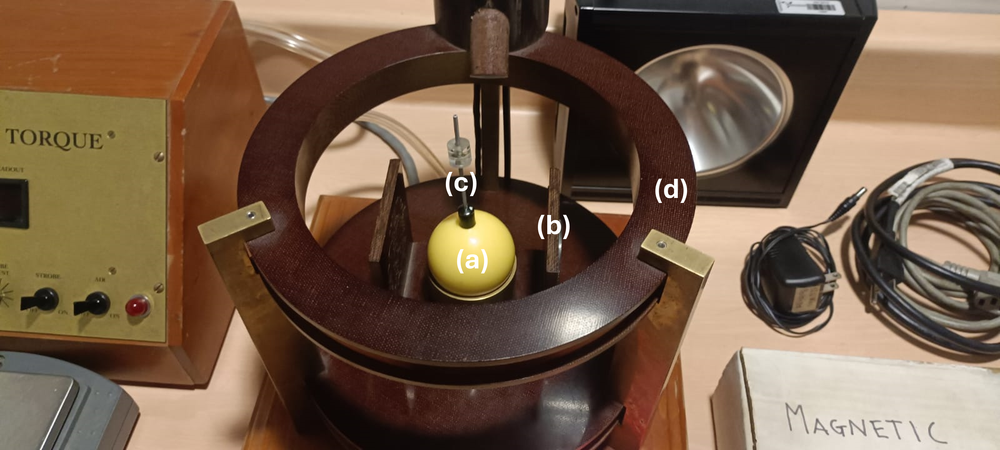

donde (a) es la esfera principal, (b) los imanes estáticos empleados en el ejercicio de resonancia magnética, (c) la vara que genera el torque de la actividad #2 y (d) las bobinas de Helmholtz que generan el campo magnético uniforme en su interior.

---

> **Errores:**

Al contrario que con montajes anteriores, los errores asociados a cada medición serán expuestos desde este momento. De esta manera, el reporte de incertidumbres será mucho más adecuado.

In [4]:
E_lenght = 0.00005 # m (Incertidumbre de las medidas de longitud)
E_mass = 0.0001 # kg (Incertidumbre de las medidas de masa)
E_current = 0.05 # A (Incertidumbre de las medidas de corriente)
E_time = 0.01 # s (Incertidumbre de las medidas de tiempo)
E_os = 0.1 # Hz (Incertidumbre del estroboscopio)

---

Para poder determinar el valor del momento magnético de este sistema físico se emplearán tres métodos: Equilibrio Estático, Oscilador Armónico y Precesión. El objetivo de la práctica es conseguir que los valores de momento magnético obtenidos para cada actividad sean lo más semejantes y precisos posibles.

---

> **Actividad #1: Equilibrio Estático.**

En este primer escenario se emplea un acercamiento algo más inexacto para poder determinar el valor del momento magnético. Partiendo de una relación de torques producto de la presencia de una masa a una distancia $r$ de la esfera, buscamos determinar los valores de corriente que balanceaban el torque para que la vara estuviese a un ángulo cercano a los $45^{\circ}$. Partiendo de esta información se busca construir una regresión de la forma:

$$rmg = \mu{B} - dMg$$

dado $r$ la distacia en que se aleja la masa del centro de la esfera, $m$ el valor de la masa exterior, $B$ el valor de campo magnético, $M$ la masa de la varilla y $d$ la distancia del centro de la esfera al centro de masas de la varilla. En este caso es suficiente con tomar la pendiente de la regresión para obtener el valor de momento magnético $\mu$.

In [67]:
B0 = 1.36*1e-3 # T/A (Campo Magnético producido por un amperio en el montaje)
mass = 1.5*1e-3 # kg (Masa en la varilla)
gravity = 9.81 # m/s^{2} (Aceleración de la gravedad)
diameter = 0.05345 # m (Diametro de la esfera)
Mass = 141.3*1e-3 # kg (Masa de la esfera)
black_thing = 6.52*1e-2 - diameter # m (Longitud de la pieza negra que sobresale de la esfera)
rest_lenght = diameter/2 + black_thing
diameter/2

0.026725

In [6]:
Data_1 = pd.read_excel(path + "Static Equilibrium.xlsx")
Radius = Data_1["Radius [m]"].to_numpy() + rest_lenght
Current = Data_1["Current [A]"].to_numpy()
Torque = mass*gravity*Radius

In [7]:
r, m, g, uncr, uncm, uncg = sym.symbols("r, m, g, sigma_r, sigma_m, sigma_g", real = True)
Torque_sym = r, m, g, uncr, uncm, uncg
Torque_exp = r*m*g

Torque = np.array([])
unc_Torque = np.array([])

for i in range(0, len(Radius)):
    torque_param = (Radius[i], mass, gravity, E_lenght, E_mass, 0)
    torque, unc_torque = Computation_Error(Torque_exp, Torque_sym, torque_param)
    Torque = np.append(Torque, torque)
    unc_Torque = np.append(unc_Torque, unc_torque)

In [8]:
I, B, uncI, uncB = sym.symbols("I, B, sigma_I, sigma_B", real = True)
MagField_sym = I, B, uncI, uncB
MagField_exp = I*B

MagField = np.array([])
unc_MagField = np.array([])

for i in range(0, len(Current)):
    magField_param = (Current[i], B0, E_current, 0)
    magField, unc_magField = Computation_Error(MagField_exp, MagField_sym, magField_param)
    MagField = np.append(MagField, magField)
    unc_MagField = np.append(unc_MagField, unc_magField)

In [9]:
Torque_var, Torque_unc = np.polyfit(MagField, Torque, 1, cov = True)
Torque_unc = np.sqrt(np.diag(Torque_unc))

Magnetic_ = np.linspace(min(MagField), max(MagField), 100)
Torque_ = Linear(Magnetic_, *Torque_var)

In [10]:
Res_Torque = Torque - Linear(MagField, *Torque_var)
std_ResTorque = np.std(Res_Torque, ddof=1)
normRes_Torque = Res_Torque/std_ResTorque

<IPython.core.display.Javascript object>


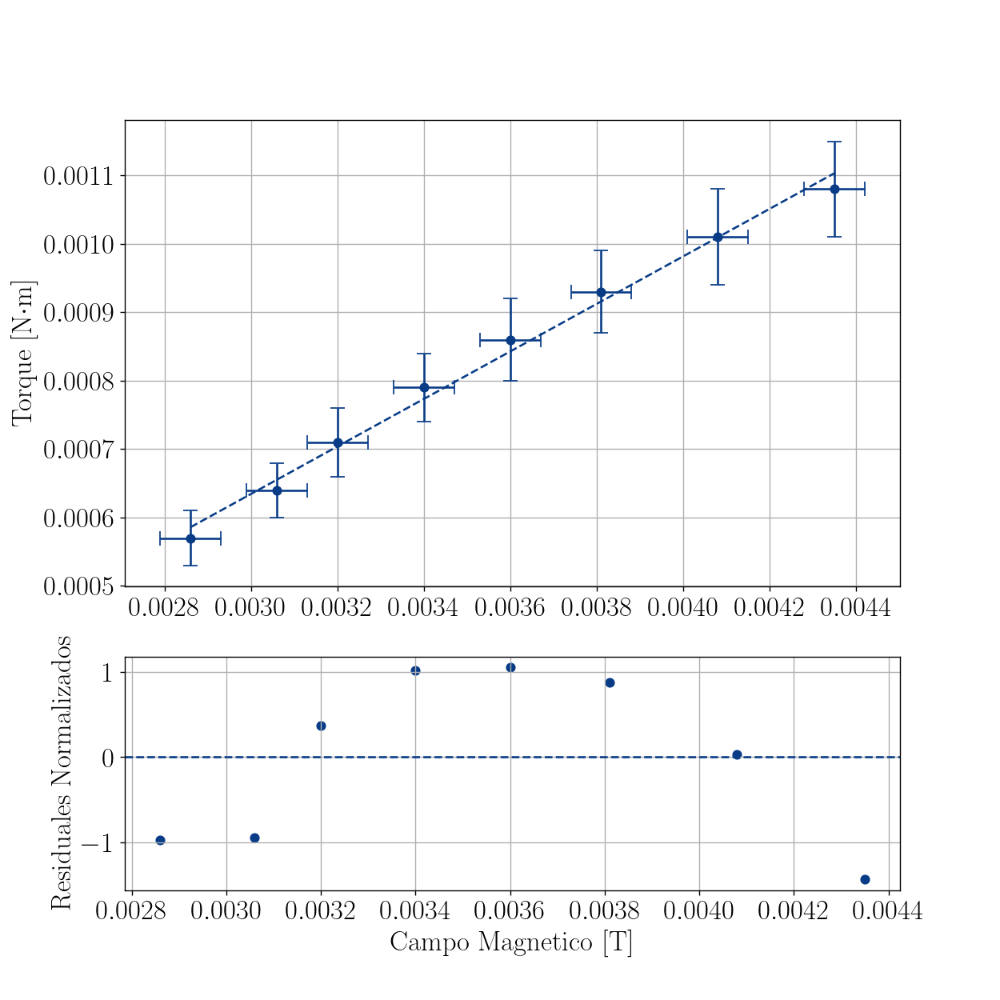

In [11]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
axis[0].errorbar(MagField, Torque, xerr = unc_MagField, yerr = unc_Torque, color = "#083c87", capsize = 5, fmt = "o")
axis[0].plot(Magnetic_, Torque_, color = "#083c87", linestyle = "--")
axis[0].set_ylabel(r"Torque [N$\cdot$m]")
axis[0].grid(True)

axis[1].set_xlabel(r"Campo Magnetico [T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].scatter(MagField, normRes_Torque, color = "#083c87")
axis[1].axhline(0, color = "#083c87", linestyle = "--")
axis[1].grid(True)
#plt.savefig("Primer Mu.pdf")

In [12]:
Torque_var[0], Torque_unc[0] = Error(Torque_var[0], Torque_unc[0])
display(Markdown("El valor del momento magnético es de aproximadamente $\mu = {} \pm {}$ A$\cdot$m$^2$".format(Torque_var[0], Torque_unc[0])))

El valor del momento magnético es de aproximadamente $\mu = 0.35 \pm 0.01$ A$\cdot$m$^2$

Como se logra apreciar, el valor obtenido para el momento magnético del montaje se aproxima de manera significativa a los $0.4$ A$\cdot$m$^{2}$.

---

> **Actividad #2: Oscilación Armonica.**

En esta segunda actividad se realizaron mediciones del periodo de oscilación de esta esfera amarilla. Partiendo de dichas mediciones, se procedió a la determinación del momento magnético al considerar una regresión de la forma:

$$T^{2} = \frac{4\pi^{2}I}{\mu{B}}$$

donde $I$ es el momento de inercia asociado a la esfera, el cual se calcula de la forma:

$$I = \frac{2}{5}MR^{2}$$

donde $M$ es la masa de la esfera y $R$ su radio.

---

Estos son los resultados con el primer grupo de datos:

In [66]:
M, R, uncM, uncR = sym.symbols("M, R, sigma_M, sigma_R", real = True)
Inertia_sym = M, R, uncM, uncR
Inertia_exp = (2/5)*M*(R**2)

Inertia_param = (Mass, diameter/2, E_mass, E_lenght)
Inertia_, unc_Inertia_ = Computation_Error(Inertia_exp, Inertia_sym, Inertia_param)
Inertia_, unc_Inertia_

(4.04e-05, 2e-07)

In [14]:
Second = []

In [15]:
Data_2 = pd.read_excel(path + "Harmonic Oscilation.xlsx")
Current_ = Data_2["Current [A]"].to_numpy()
Time = Data_2["Time [s]"].to_numpy()/20

In [16]:
T, uncT = sym.symbols("T, sigma_T", real = True)
Time_sym = T, uncT
Time_exp = (T)**2

Time2 = np.array([])
unc_Time2 = np.array([])

for i in range(0, len(Time)):
    time_param = (Time[i], E_time)
    time, unc_time = Computation_Error(Time_exp, Time_sym, time_param)
    Time2 = np.append(Time2, time)
    unc_Time2 = np.append(unc_Time2, unc_time)

In [17]:
I, B, uncI, uncB = sym.symbols("I, B, sigma_I, sigma_B", real = True)
MagField_sym = I, B, uncI, uncB
MagField_exp = 1/(I*B)

_MagField = np.array([])
_unc_MagField = np.array([])

for i in range(0, len(Current_)):
    magField_param = (Current_[i], B0, E_current, 0)
    magField, unc_magField = Computation_Error(MagField_exp, MagField_sym, magField_param)
    _MagField = np.append(_MagField, magField)
    _unc_MagField = np.append(_unc_MagField, unc_magField)

In [18]:
Strange_var, Strange_unc = np.polyfit(_MagField, Time2, 1, cov = True)
Strange_unc = np.sqrt(np.diag(Strange_unc))

_Magnetic_ = np.linspace(min(_MagField), max(_MagField), 100)
Strange_ = Linear(_Magnetic_, *Strange_var)

In [19]:
Res_Time2 = Time2 - Linear(_MagField, *Strange_var)
std_ResTime2 = np.std(Res_Time2, ddof=1)
normRes_Time2 = Res_Time2/std_ResTime2

<IPython.core.display.Javascript object>


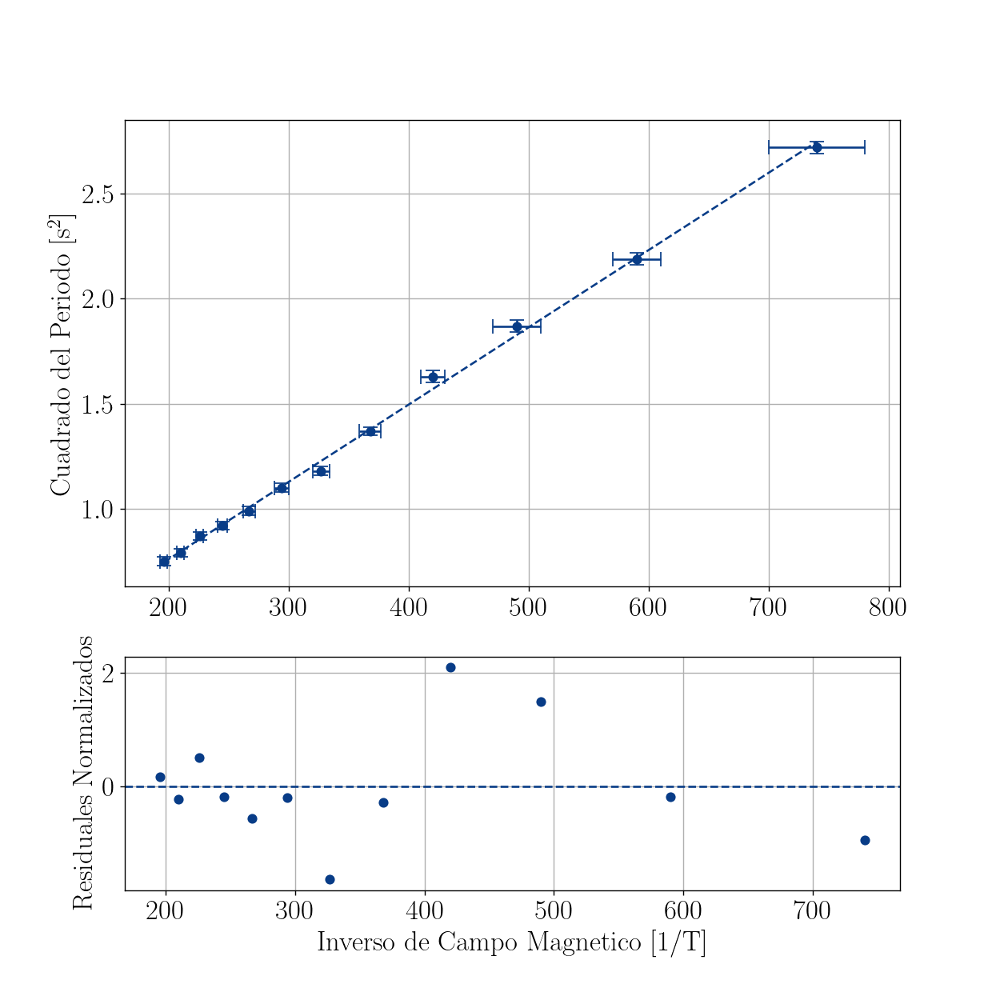

In [20]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
axis[0].errorbar(_MagField, Time2, xerr = _unc_MagField, yerr = unc_Time2, color = "#083c87", capsize = 5, fmt = "o")
axis[0].plot(_Magnetic_, Strange_, color = "#083c87", linestyle = "--")
axis[0].set_ylabel(r"Cuadrado del Periodo [s$^2$]")
axis[0].grid(True)

axis[1].set_xlabel(r"Inverso de Campo Magnetico [1/T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].scatter(_MagField, normRes_Time2, color = "#083c87")
axis[1].axhline(0, color = "#083c87", linestyle = "--")
axis[1].grid(True)

Sabemos de la forma de la regresión que se debe cumplir que:

$$m = \frac{4\pi^{2}I}{\mu} \quad \Rightarrow \quad \mu = \frac{4\pi^{2}I}{m}$$

donde $m$ es la pendiente de la regresión. Este cálculo nos da:

In [21]:
I, m, uncI, uncm = sym.symbols("I, m, sigma_I, sigma_m", real = True)
MomMag_sym = I, m, uncI, uncm
MomMag_exp = 4*(np.pi**2)*(I/m)
MomMag_param = (Inertia_, Strange_var[0], unc_Inertia_, Strange_unc[0])
MomMag, unc_MomMag = Computation_Error(MomMag_exp, MomMag_sym, MomMag_param)

In [22]:
Second.append({"Primera Medición":(_MagField, Time2, _Magnetic_, Strange_), "Errors":(_unc_MagField, unc_Time2), "Other":(_MagField, normRes_Time2), "Magnetic":(MomMag, unc_MomMag)})

In [23]:
display(Markdown("El valor del momento magnético es de aproximadamente $\mu = {} \pm {}$ A$\cdot$m$^2$".format(MomMag, unc_MomMag)))

El valor del momento magnético es de aproximadamente $\mu = 0.433 \pm 0.007$ A$\cdot$m$^2$

---

Para el segundo conjunto de datos se tiene:

In [24]:
Time = Data_2["Time 2 [s]"].to_numpy()/20

In [25]:
T, uncT = sym.symbols("T, sigma_T", real = True)
Time_sym = T, uncT
Time_exp = (T)**2

Time2 = np.array([])
unc_Time2 = np.array([])

for i in range(0, len(Time)):
    time_param = (Time[i], E_time)
    time, unc_time = Computation_Error(Time_exp, Time_sym, time_param)
    Time2 = np.append(Time2, time)
    unc_Time2 = np.append(unc_Time2, unc_time)

In [26]:
Strange_var, Strange_unc = np.polyfit(_MagField, Time2, 1, cov = True)
Strange_unc = np.sqrt(np.diag(Strange_unc))

_Magnetic_ = np.linspace(min(_MagField), max(_MagField), 100)
Strange_ = Linear(_Magnetic_, *Strange_var)

In [27]:
Res_Time2 = Time2 - Linear(_MagField, *Strange_var)
std_ResTime2 = np.std(Res_Time2, ddof=1)
normRes_Time2 = Res_Time2/std_ResTime2

<IPython.core.display.Javascript object>


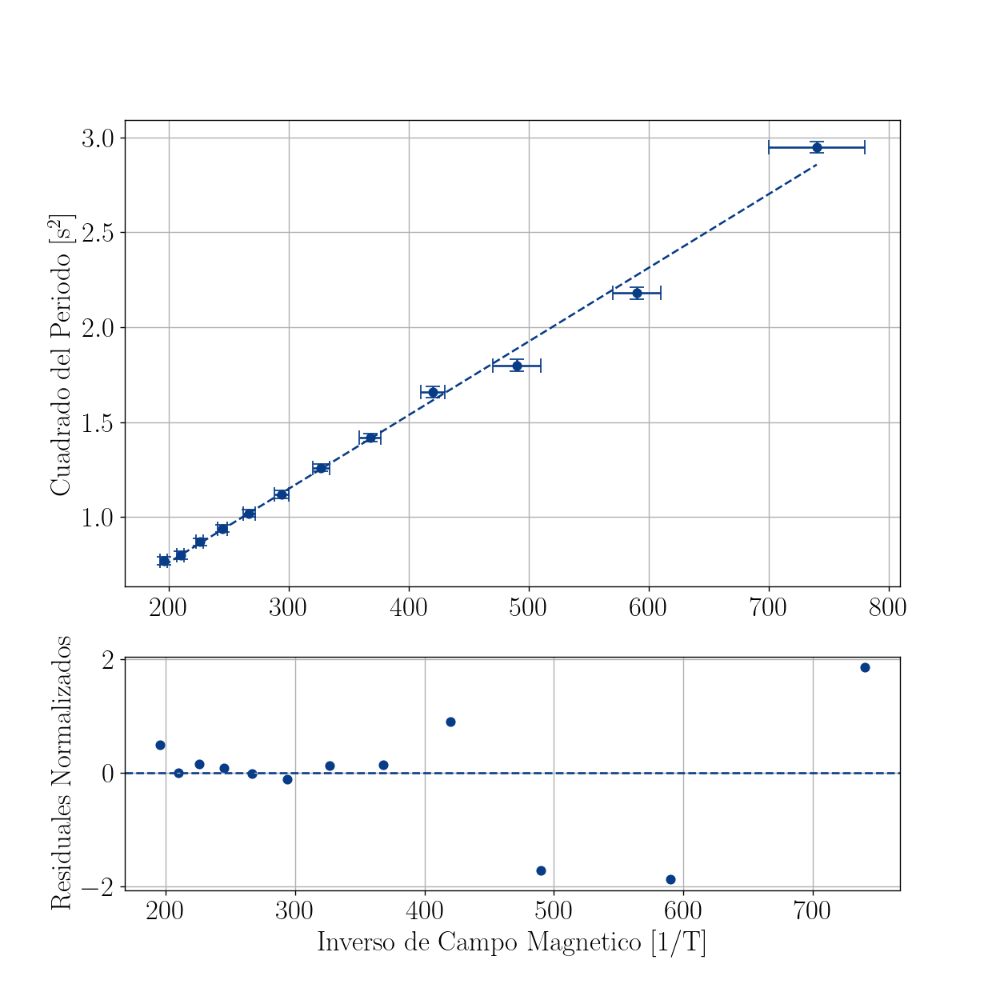

In [28]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
axis[0].errorbar(_MagField, Time2, xerr = _unc_MagField, yerr = unc_Time2, color = "#083c87", capsize = 5, fmt = "o")
axis[0].plot(_Magnetic_, Strange_, color = "#083c87", linestyle = "--")
axis[0].set_ylabel(r"Cuadrado del Periodo [s$^2$]")
axis[0].grid(True)

axis[1].set_xlabel(r"Inverso de Campo Magnetico [1/T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].scatter(_MagField, normRes_Time2, color = "#083c87")
axis[1].axhline(0, color = "#083c87", linestyle = "--")
axis[1].grid(True)

In [29]:
I, m, uncI, uncm = sym.symbols("I, m, sigma_I, sigma_m", real = True)
MomMag_sym = I, m, uncI, uncm
MomMag_exp = 4*(np.pi**2)*(I/m)
MomMag_param = (Inertia_, Strange_var[0], unc_Inertia_, Strange_unc[0])
MomMag, unc_MomMag = Computation_Error(MomMag_exp, MomMag_sym, MomMag_param)

In [30]:
Second.append({"Segunda Medición":(_MagField, Time2, _Magnetic_, Strange_), "Errors":(_unc_MagField, unc_Time2),"Other":(_MagField, normRes_Time2), "Magnetic":(MomMag, unc_MomMag)})

In [31]:
display(Markdown("El valor del momento magnético es de aproximadamente $\mu = {} \pm {}$ A$\cdot$m$^2$".format(MomMag, unc_MomMag)))

El valor del momento magnético es de aproximadamente $\mu = 0.41 \pm 0.01$ A$\cdot$m$^2$

---

> **Actividad #3: Precesión.**

Partiendo de la siguiente expresión, la llamada frecuencia de Larmor (en el ámbito clásico):

$$\Omega = \frac{\mu{B}}{L_{s}}$$

Las ecuaciones que definen las variables, con respecto a los datos recopilados en el laboratorio:

$$\Omega = \frac{2\pi}{T_{e}} \quad \text{ y } \quad L_{s} = I\omega = I\cdot2\pi{f_{O}}$$

donde $T_{e}$ es el periodo de la esfera, $I$ el momento de inercia de la esfera y $f_{O}$ es la frecuencia del ostroboscopio.

---

Para el primer conjunto de datos se tiene:

In [32]:
Data_3 = pd.read_excel(path + "Precession.xlsx")
_Current_ = Data_3["Current [A]"].to_numpy()
Freq4 = Data_3["Period [s] (4.5 Hz)"].to_numpy()
f0 = 4.5

In [33]:
Third = []

In [34]:
T, uncT = sym.symbols("T, sigma_T", real = True)
Omega_sym = T, uncT
Omega_exp = 2*np.pi/T

Omega = np.array([])
unc_Omega = np.array([])

for i in range(0, len(Freq4)):
    omega_param = (Freq4[i], E_time)
    omega, unc_omega = Computation_Error(Omega_exp, Omega_sym, omega_param)
    Omega = np.append(Omega, omega)
    unc_Omega = np.append(unc_Omega, unc_omega)

In [35]:
I, f, uncI, uncf = sym.symbols("I, f, sigma_I, sigma_f", real = True)
Ls_sym = I, f, uncI, uncf
Ls_exp = 2*np.pi*I*f

Ls_param = (Inertia_, f0, unc_Inertia_, 0.1)
Ls, unc_Ls = Computation_Error(Ls_exp, Ls_sym, Ls_param)

In [36]:
I, B, uncI, uncB = sym.symbols("I, B, sigma_I, sigma_B", real = True)
MagField_sym = I, B, uncI, uncB
MagField_exp = I*B

_MagField_ = np.array([])
_unc_MagField_ = np.array([])

for i in range(0, len(_Current_)):
    magField_param = (_Current_[i], B0, E_current, 0)
    magField, unc_magField = Computation_Error(MagField_exp, MagField_sym, magField_param)
    _MagField_ = np.append(_MagField_, magField)
    _unc_MagField_ = np.append(_unc_MagField_, unc_magField)

In [37]:
Omega_var, Omega_unc = np.polyfit(_MagField_, Omega, 1, cov = True)
Omega_unc = np.sqrt(np.diag(Omega_unc))

__Magnetic__ = np.linspace(min(_MagField_), max(_MagField_), 100)
Omega_ = Linear(__Magnetic__, *Omega_var)

In [38]:
Res_Omega = Omega - Linear(_MagField_, *Omega_var)
std_Omega = np.std(Res_Omega, ddof=1)
normRes_Omega = Res_Omega/std_Omega

<IPython.core.display.Javascript object>


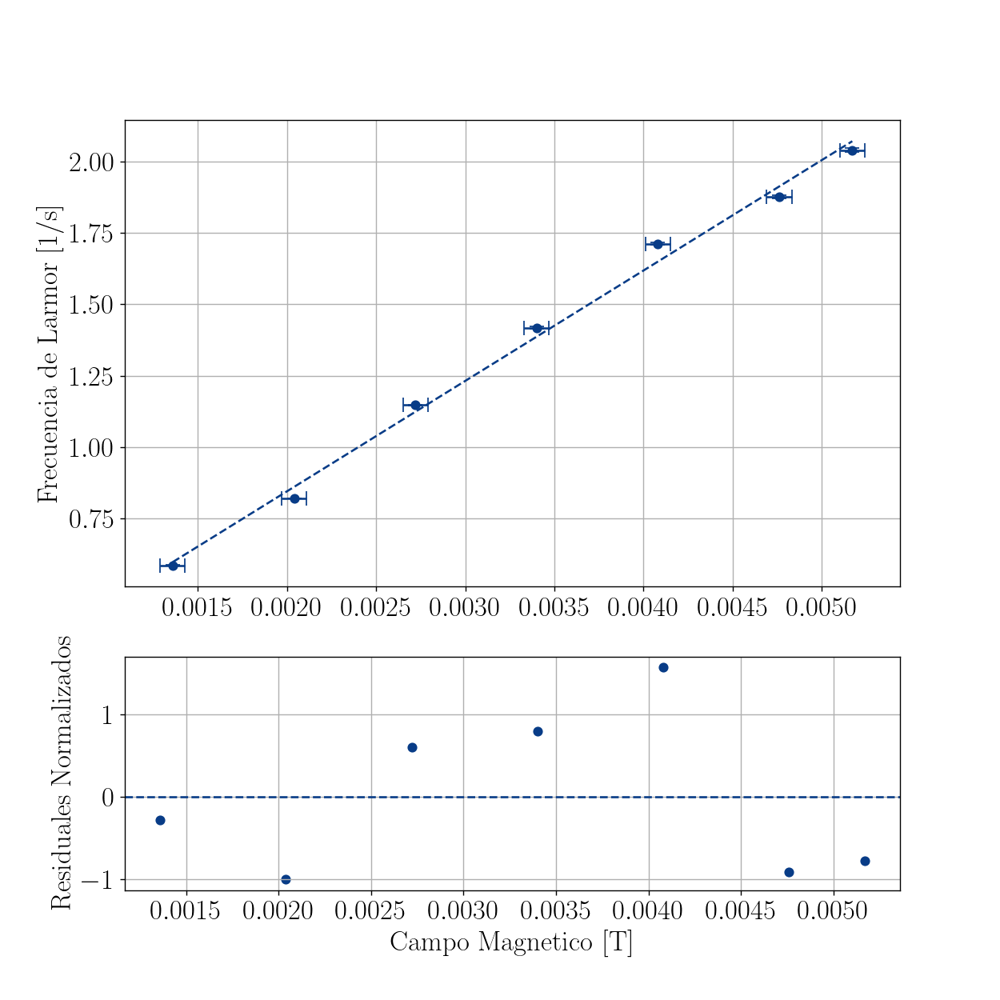

In [39]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
axis[0].errorbar(_MagField_, Omega, xerr = _unc_MagField_, yerr = unc_Omega, color = "#083c87", capsize = 5, fmt = "o")
axis[0].plot(__Magnetic__, Omega_, color = "#083c87", linestyle = "--")
axis[0].set_ylabel(r"Frecuencia de Larmor [1$/$s]")
axis[0].grid(True)

axis[1].set_xlabel(r"Campo Magnetico [T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].scatter(_MagField_, normRes_Omega, color = "#083c87")
axis[1].axhline(0, color = "#083c87", linestyle = "--")
axis[1].grid(True)

De este cálculo es posible obtener que el momento magnético tiene que ser igual a:

$$m = \frac{\mu}{L_{s}} \quad \Rightarrow \quad \mu = mL_{s}$$

In [40]:
m, Ls_, uncm, uncLs = sym.symbols("m, L_s, sigma_m, sigma_L_s", real = True)
MomMag_sym = m, Ls_, uncm, uncLs
MomMag_exp = m*Ls
MomMag_param = (Omega_var[0], Ls, Omega_unc[0], unc_Ls)
MomMag, unc_MomMag = Computation_Error(MomMag_exp, MomMag_sym, MomMag_param)

In [41]:
Third.append({"4.5 Hz":(_MagField_, Omega, __Magnetic__, Omega_), "Errors":(_unc_MagField_, unc_Omega), "Other":(_MagField_, normRes_Omega),  "Magnetic":(MomMag, unc_MomMag)})

In [42]:
display(Markdown("El valor del momento magnético es de aproximadamente $\mu = {} \pm {}$ A$\cdot$m$^2$".format(MomMag, unc_MomMag)))

El valor del momento magnético es de aproximadamente $\mu = 0.44 \pm 0.01$ A$\cdot$m$^2$

---

Para el segundo conjunto de datos:

In [43]:
Freq5 = Data_3["Period [s] (5 Hz)"].to_numpy()
f0 = 5

In [44]:
T, uncT = sym.symbols("T, sigma_T", real = True)
Omega_sym = T, uncT
Omega_exp = 2*np.pi/T

Omega = np.array([])
unc_Omega = np.array([])

for i in range(0, len(Freq5)):
    omega_param = (Freq5[i], E_time)
    omega, unc_omega = Computation_Error(Omega_exp, Omega_sym, omega_param)
    Omega = np.append(Omega, omega)
    unc_Omega = np.append(unc_Omega, unc_omega)

In [45]:
I, f, uncI, uncf = sym.symbols("I, f, sigma_I, sigma_f", real = True)
Ls_sym = I, f, uncI, uncf
Ls_exp = 2*np.pi*I*f

Ls_param = (Inertia_, f0, unc_Inertia_, 0.1)
Ls, unc_Ls = Computation_Error(Ls_exp, Ls_sym, Ls_param)

In [46]:
Omega_var, Omega_unc = np.polyfit(_MagField_, Omega, 1, cov = True)
Omega_unc = np.sqrt(np.diag(Omega_unc))

__Magnetic__ = np.linspace(min(_MagField_), max(_MagField_), 100)
Omega_ = Linear(__Magnetic__, *Omega_var)

In [47]:
Res_Omega = Omega - Linear(_MagField_, *Omega_var)
std_Omega = np.std(Res_Omega, ddof=1)
normRes_Omega = Res_Omega/std_Omega

<IPython.core.display.Javascript object>


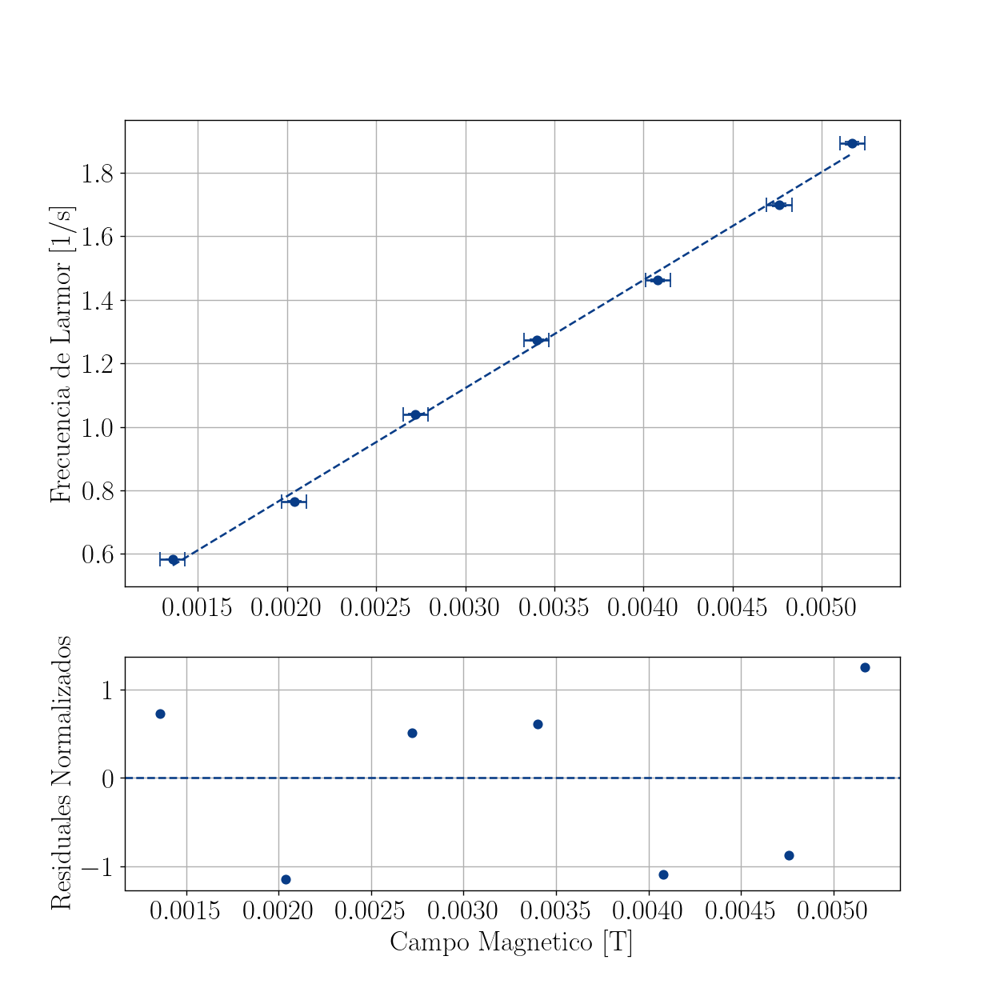

In [48]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
axis[0].errorbar(_MagField_, Omega, xerr = _unc_MagField_, yerr = unc_Omega, color = "#083c87", capsize = 5, fmt = "o")
axis[0].plot(__Magnetic__, Omega_, color = "#083c87", linestyle = "--")
axis[0].set_ylabel(r"Frecuencia de Larmor [1$/$s]")
axis[0].grid(True)

axis[1].set_xlabel(r"Campo Magnetico [T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].scatter(_MagField_, normRes_Omega, color = "#083c87")
axis[1].axhline(0, color = "#083c87", linestyle = "--")
axis[1].grid(True)

In [49]:
m, Ls_, uncm, uncLs = sym.symbols("m, L_s, sigma_m, sigma_L_s", real = True)
MomMag_sym = m, Ls_, uncm, uncLs
MomMag_exp = m*Ls
MomMag_param = (Omega_var[0], Ls, Omega_unc[0], unc_Ls)
MomMag, unc_MomMag = Computation_Error(MomMag_exp, MomMag_sym, MomMag_param)

In [50]:
Third.append({"5 Hz":(_MagField_, Omega, __Magnetic__, Omega_),"Errors":(_unc_MagField_, unc_Omega),"Other":(_MagField_, normRes_Omega), "Magnetic":(MomMag, unc_MomMag)})

In [51]:
display(Markdown("El valor del momento magnético es de aproximadamente $\mu = {} \pm {}$ A$\cdot$m$^2$".format(MomMag, unc_MomMag)))

El valor del momento magnético es de aproximadamente $\mu = 0.43 \pm 0.01$ A$\cdot$m$^2$

---

Para el tercer y último conjunto de datos:

In [52]:
Freq6 = Data_3["Period [s] (6 Hz)"].to_numpy()
f0 = 6

In [53]:
T, uncT = sym.symbols("T, sigma_T", real = True)
Omega_sym = T, uncT
Omega_exp = 2*np.pi/T

Omega = np.array([])
unc_Omega = np.array([])

for i in range(0, len(Freq6)):
    omega_param = (Freq6[i], E_time)
    omega, unc_omega = Computation_Error(Omega_exp, Omega_sym, omega_param)
    Omega = np.append(Omega, omega)
    unc_Omega = np.append(unc_Omega, unc_omega)

In [54]:
I, f, uncI, uncf = sym.symbols("I, f, sigma_I, sigma_f", real = True)
Ls_sym = I, f, uncI, uncf
Ls_exp = 2*np.pi*I*f

Ls_param = (Inertia_, f0, unc_Inertia_, 0.1)
Ls, unc_Ls = Computation_Error(Ls_exp, Ls_sym, Ls_param)

In [55]:
Omega_var, Omega_unc = np.polyfit(_MagField_, Omega, 1, cov = True)
Omega_unc = np.sqrt(np.diag(Omega_unc))

__Magnetic__ = np.linspace(min(_MagField_), max(_MagField_), 100)
Omega_ = Linear(__Magnetic__, *Omega_var)

In [56]:
Res_Omega = Omega - Linear(_MagField_, *Omega_var)
std_Omega = np.std(Res_Omega, ddof=1)
normRes_Omega = Res_Omega/std_Omega

<IPython.core.display.Javascript object>


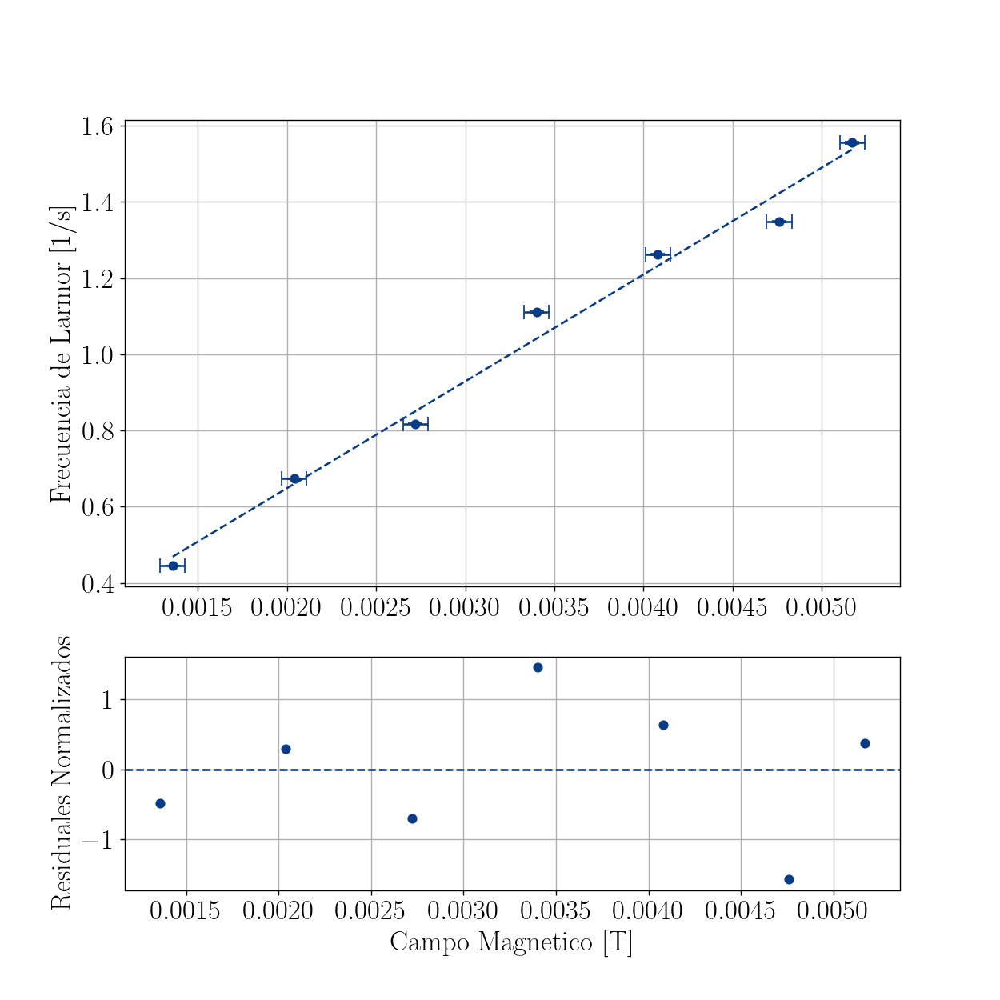

In [57]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
axis[0].errorbar(_MagField_, Omega, xerr = _unc_MagField_, yerr = unc_Omega, color = "#083c87", capsize = 5, fmt = "o")
axis[0].plot(__Magnetic__, Omega_, color = "#083c87", linestyle = "--")
axis[0].set_ylabel(r"Frecuencia de Larmor [1$/$s]")
axis[0].grid(True)

axis[1].set_xlabel(r"Campo Magnetico [T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].scatter(_MagField_, normRes_Omega, color = "#083c87")
axis[1].axhline(0, color = "#083c87", linestyle = "--")
axis[1].grid(True)

In [58]:
m, Ls_, uncm, uncLs = sym.symbols("m, L_s, sigma_m, sigma_L_s", real = True)
MomMag_sym = m, Ls_, uncm, uncLs
MomMag_exp = m*Ls
MomMag_param = (Omega_var[0], Ls, Omega_unc[0], unc_Ls)
MomMag, unc_MomMag = Computation_Error(MomMag_exp, MomMag_sym, MomMag_param)

In [59]:
Third.append({"6 Hz":(_MagField_, Omega, __Magnetic__, Omega_), "Errors":(_unc_MagField_, unc_Omega), "Other":(_MagField_, normRes_Omega), "Magnetic":(MomMag, unc_MomMag)})

In [60]:
display(Markdown("El valor del momento magnético es de aproximadamente $\mu = {} \pm {}$ A$\cdot$m$^2$".format(MomMag, unc_MomMag)))

El valor del momento magnético es de aproximadamente $\mu = 0.43 \pm 0.02$ A$\cdot$m$^2$

Como observación general de todo el experimento, los valores que se obtuvieron para el momento magnético se encuentran en el mismo orden de magnitud y, en ocasiones, muy cerca del valor esperado, $0.4$ A$\cdot$m$^2$. La discusión profunda al respecto de la resonancia magnética queda reservada para el informe.

---

Para estas dos últimas actividades aquí se muestran las modificaciones para observar los resultados obtenidos. Para la **segunda actividad** se tiene:

In [61]:
Color = ["#0C79C4", "#F49D0E", "#C21010"]

<IPython.core.display.Javascript object>


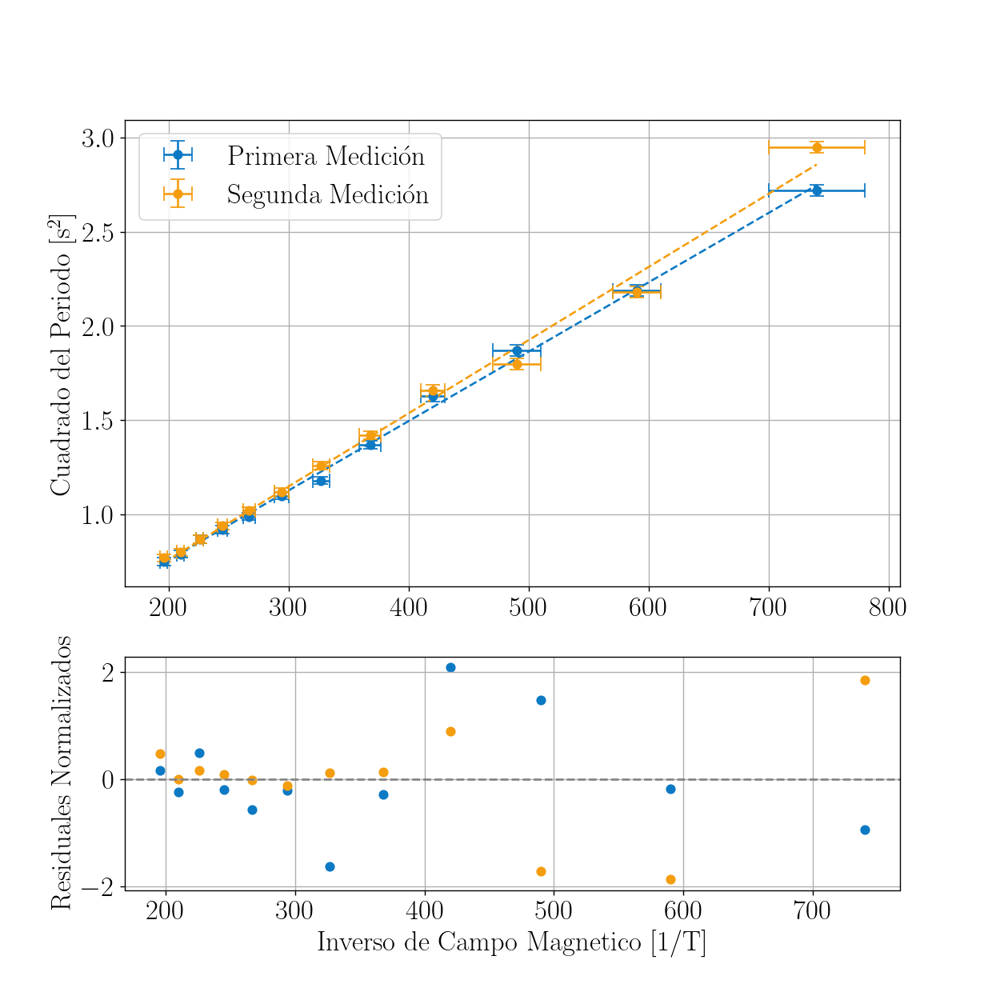

In [62]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
MuSecond = []
for i in range(0, len(Second)):
    MuSecond.append(Second[i]["Magnetic"])
    if i == 0:
        dataPiv = Second[i]["Primera Medición"]
        leg = "Primera Medición"
    if i == 1:
        dataPiv = Second[i]["Segunda Medición"]
        leg = "Segunda Medición"
        
    errorPiv = Second[i]["Errors"]
    otherPiv = Second[i]["Other"]
    
    axis[0].errorbar(dataPiv[0], dataPiv[1], xerr = errorPiv[0], yerr = errorPiv[1], color = Color[i], capsize = 5, label = leg, fmt = "o")
    axis[0].plot(dataPiv[2], dataPiv[3], color = Color[i], linestyle = "--")
    axis[1].scatter(otherPiv[0], otherPiv[1], color = Color[i])


axis[0].set_ylabel(r"Cuadrado del Periodo [s$^2$]")
axis[0].legend()
axis[0].grid(True)

axis[1].set_xlabel(r"Inverso de Campo Magnetico [1/T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].axhline(0, color = "gray", linestyle = "--")
axis[1].grid(True)
#plt.savefig("Segundo Mu.pdf")

In [63]:
MuSecond

[(0.433, 0.007), (0.41, 0.01)]

Para la **tercera actividad** se tiene:

<IPython.core.display.Javascript object>


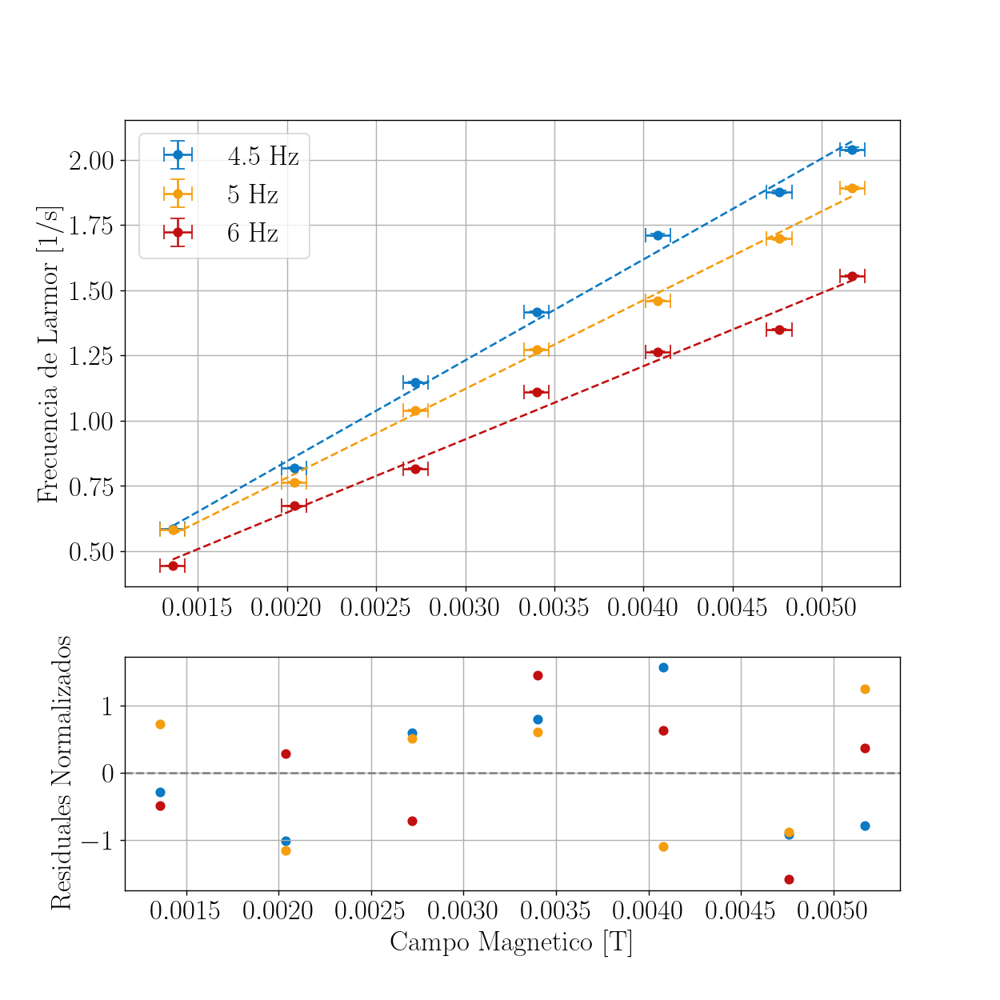

In [64]:
figure, axis = plt.subplots(2, 1, figsize = (10, 10), gridspec_kw = {"height_ratios": [2, 1]})
MuThird = []
for i in range(0, len(Third)):
    MuThird.append(Third[i]["Magnetic"])
    if i == 0:
        dataPiv = Third[i]["4.5 Hz"]
        leg = "4.5 Hz"
    if i == 1:
        dataPiv = Third[i]["5 Hz"]
        leg = "5 Hz"
    if i == 2:
        dataPiv = Third[i]["6 Hz"]
        leg = "6 Hz"
        
    errorPiv = Third[i]["Errors"]
    otherPiv = Third[i]["Other"]
    
    axis[0].errorbar(dataPiv[0], dataPiv[1], xerr = errorPiv[0], yerr = errorPiv[1], color = Color[i], capsize = 5, label = leg, fmt = "o")
    axis[0].plot(dataPiv[2], dataPiv[3], color = Color[i], linestyle = "--")
    axis[1].scatter(otherPiv[0], otherPiv[1], color = Color[i])


axis[0].set_ylabel(r"Frecuencia de Larmor [1$/$s]")
axis[0].legend()
axis[0].grid(True)

axis[1].set_xlabel(r"Campo Magnetico [T]")
axis[1].set_ylabel(r"Residuales Normalizados")
axis[1].axhline(0, color = "gray", linestyle = "--")
axis[1].grid(True)
#plt.savefig("Tercer Mu.pdf")

In [65]:
MuThird

[(0.44, 0.01), (0.43, 0.01), (0.43, 0.02)]